In [1]:
import plotly.express as px
import pandas as pd
import numpy as np
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from matplotlib import pyplot as plt
from DBSCAN import findEps, dbscan
from KMeans import ElbowMethod
from scaling import standardize, normalize
import warnings
warnings.filterwarnings("ignore")

# Flokker

In [2]:
df2015 = pd.read_csv('../data/kaasa/kaasa_2015.csv')
df2016 = pd.read_csv('../data/kaasa/kaasa_2016.csv')
df2017 = pd.read_csv('../data/kaasa/kaasa_2017.csv')
df2018 = pd.read_csv('../data/kaasa/kaasa_2018.csv')
df2019 = pd.read_csv('../data/kaasa/kaasa_2019.csv')
df2020 = pd.read_csv('../data/kaasa/kaasa_2020.csv')
df2021 = pd.read_csv('../data/kaasa/kaasa_2021.csv')

files = [df2015, df2016, df2017, df2018, df2019, df2020, df2021]

#df = df.drop(columns=['source_id', 'individual', 'owner_id', 'name', 'attack'])
#df = standardize(df, ['velocity', 'temperature', 'altitude', 'sin_time', 'cos_time', 'longitude', 'latitude', 'date_time', 'distance']) # standarize the data
#df = standardize(df, ['velocity', 'temperature', 'altitude', 'sin_time', 'cos_time', 'longitude', 'latitude', 'date_time', 'distance']) # standarize the data
#df = normalize(df, ['velocity', 'temperature', 'altitude', 'sin_time', 'cos_time', 'longitude', 'latitude', 'date_time', 'distance', ], -1, 1) # normalize the data


In [19]:
def kmeans(df, num_cluster):
    kmeans = KMeans(n_clusters=num_cluster, max_iter=1000, random_state=42)
    kmeans.fit(df[df.columns[1:-1]])

    clusters = kmeans.predict(df[df.columns[1:-1]])
    df['clusters'] = clusters

    df = df.astype({"clusters": str})

    print('number in each cluster:', df['clusters'].value_counts())

    fig = px.scatter(df, x='longitude', y='latitude', color='clusters', hover_data=['clusters', 'individual'], opacity=1)
    fig.update_traces(marker=dict(size=5, line=dict(
        width=1, color='white')), selector=dict(mode='markers'))
    fig.show()

## Elbow method

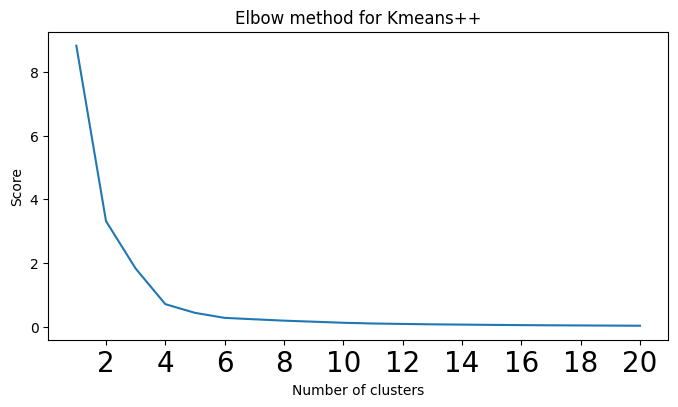

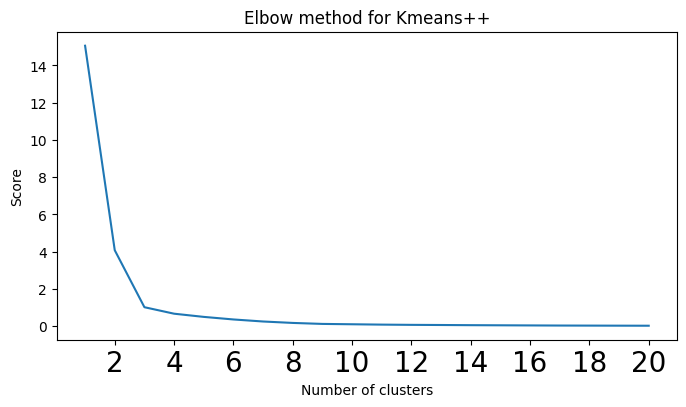

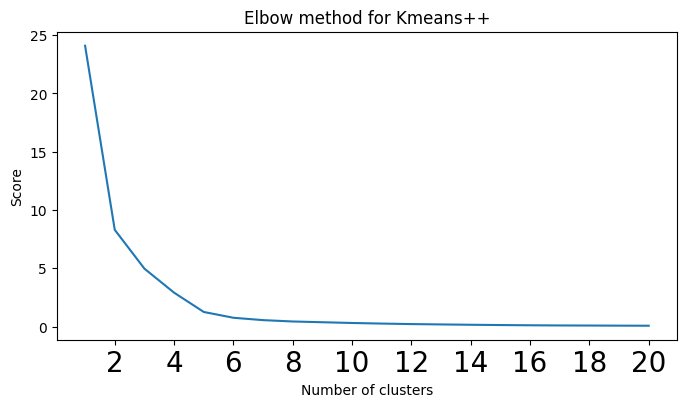

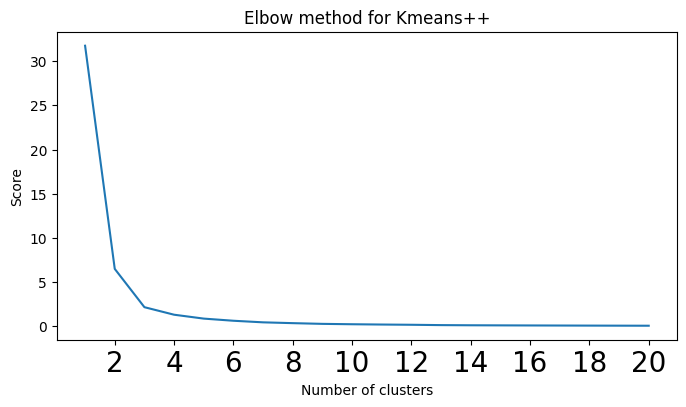

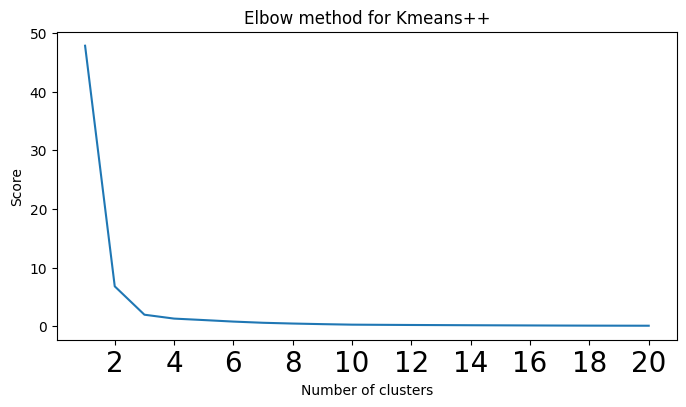

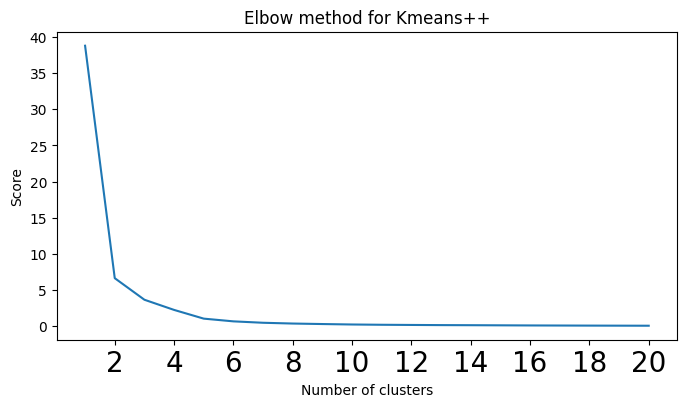

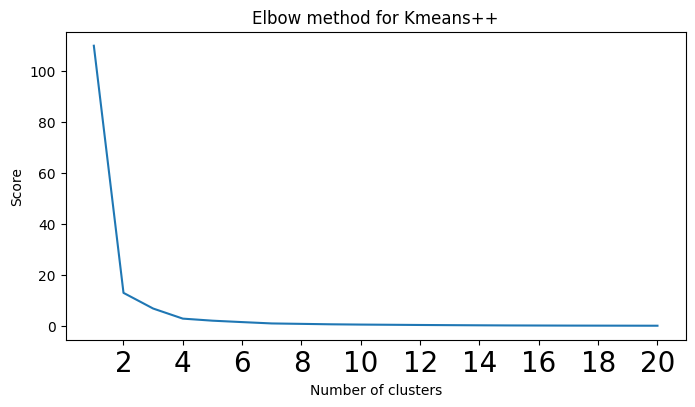

In [4]:
for file in files: 
    df = file.loc[:,['individual', 'latitude', 'longitude']]
    ElbowMethod(df[df.columns[1:-1]])



## Kmeans

In [6]:
df2015 = df2015.loc[:,['individual', 'latitude', 'longitude']]
df2016 = df2016.loc[:,['individual', 'latitude', 'longitude']]
df2017 = df2017.loc[:,['individual', 'latitude', 'longitude']]
df2018 = df2018.loc[:,['individual', 'latitude', 'longitude']]
df2019 = df2019.loc[:,['individual', 'latitude', 'longitude']]
df2020 = df2020.loc[:,['individual', 'latitude', 'longitude']]
df2021 = df2021.loc[:,['individual', 'latitude', 'longitude']]

In [21]:
cluster2015 = 4
kmeans(df2015, cluster2015)

number in each cluster: 0    10745
1     7147
2     4119
3     2163
Name: clusters, dtype: int64


In [20]:
cluster2016 = 3
kmeans(df2016, cluster2016)

number in each cluster: 0    18914
2    10515
1     3552
Name: clusters, dtype: int64


In [24]:
cluster2017 = 4
kmeans(df2017, cluster2017)

number in each cluster: 0    20997
1    14236
2     8278
3       78
Name: clusters, dtype: int64


In [42]:
cluster2018 = 3
kmeans(df2018, cluster2018)

number in each cluster: 2    7582
0    5629
1    5254
Name: clusters, dtype: int64


In [29]:
cluster2019 = 2
kmeans(df2019, cluster2019)

number in each cluster: 1    17915
0    12589
Name: clusters, dtype: int64


In [40]:
cluster2020 = 2
kmeans(df2020, cluster2020)

number in each cluster: 1    15590
0     9850
Name: clusters, dtype: int64


In [41]:
cluster2021 = 2
kmeans(df2021, cluster2021)

number in each cluster: 1    33238
0    31109
Name: clusters, dtype: int64
